<a href="https://colab.research.google.com/github/yashSal-99/PlantsUp/blob/main/PlantsUp.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import sklearn
import os
import cv2
import keras
import tensorflow as tf
import tensorflow_hub as hub
print("TensorFlow Version: ",tf.__version__)
print("tensorflow Hub version: "+hub.__version__)

#print("GPU"+"available(yess)" if tf.config.list_physical_devices("GPU") else "not available")

TensorFlow Version:  2.17.1
tensorflow Hub version: 0.16.1


# Getting Our Data Ready(making it into Tensors)

In [4]:

dataset_path = os.listdir("/content/drive/MyDrive/PlantsUp/Merged_Dataset")

print (dataset_path)  #what kinds of classes are in this dataset

print("Types of classes labels found: ", len(dataset_path))


['Doddpathre', 'Gasagase', 'Eucalyptus', 'Beans', 'Ashwagandha', 'Geranium', 'Ganigale', 'Lemongrass', 'Seethaashoka', 'Turmeric', 'Nagadali', 'Basale', 'Badipala', 'Pappaya', 'Mint', 'Nelavembu', 'Arali', 'Nooni', 'Curry', 'Henna', 'Avacado', 'Tecoma', 'Castor', 'Common rue(naagdalli)', 'Pumpkin', 'Caricature', 'Tulsi (1)', 'Rose', 'Palak(Spinach)', 'Brahmi', 'Chakte', 'Honge', 'Parijatha', 'Papaya', 'Pepper', 'Sampige', 'Seethapala', 'Ashoka', 'Ganike', 'Gauva', 'Ekka', 'Marigold', 'Tomato', 'Onion', 'camphor', 'Raddish', 'Insulin', 'Thumbe', 'Citron lime (herelikai)', 'Kasambruga', 'Raktachandini', 'Catharanthus', 'Jackfruit', 'Bhrami', 'Lemon_grass', 'Astma_weed', 'Kohlrabi', 'Tamarind', 'Guava', 'Malabar_Spinach', 'Pea', 'Curry_Leaf', 'Mango', 'Betel', 'Ginger', 'Hibiscus', 'Bringaraja', 'Lantana', 'Malabar_Nut', 'Amla', 'ashoka', 'Bamboo', 'Nerale', 'Globe Amarnath', 'Coriender', 'Aloevera', 'Sapota', 'Wood_sorel', 'kepala', 'Chilly', 'Jasmine', 'Drumstick', 'Balloon_Vine', 'Pomo

### Making DataFrame

In [5]:
# from google.colab import drive
# drive.mount('/content/drive')

In [6]:
class_labels = []

for item in dataset_path:
  # Get all the file names
  all_classes = os.listdir("/content/drive/MyDrive/PlantsUp/Merged_Dataset" + '/' +item)
  #print(all_classes)

 # Add them to the list
  for room in all_classes:
      class_labels.append((item, str('/content/drive/MyDrive/PlantsUp/Merged_Dataset' + '/' +item) + '/' + room))
      #print(class_labels[:5])



# Build a dataframe
df = pd.DataFrame(data=class_labels, columns=['Plants', 'image'])
print(df.head())
print(df.tail())

     Plants                                              image
0  Gasagase  /content/drive/MyDrive/PlantsUp/Merged_Dataset...
1  Gasagase  /content/drive/MyDrive/PlantsUp/Merged_Dataset...
2  Gasagase  /content/drive/MyDrive/PlantsUp/Merged_Dataset...
3  Gasagase  /content/drive/MyDrive/PlantsUp/Merged_Dataset...
4  Gasagase  /content/drive/MyDrive/PlantsUp/Merged_Dataset...
            Plants                                              image
12805  AmrutaBalli  /content/drive/MyDrive/PlantsUp/Merged_Dataset...
12806  AmrutaBalli  /content/drive/MyDrive/PlantsUp/Merged_Dataset...
12807  AmrutaBalli  /content/drive/MyDrive/PlantsUp/Merged_Dataset...
12808  AmrutaBalli  /content/drive/MyDrive/PlantsUp/Merged_Dataset...
12809  AmrutaBalli  /content/drive/MyDrive/PlantsUp/Merged_Dataset...


In [7]:

# Build a dataframe
labels_df = pd.DataFrame(data=class_labels, columns=['Plants', 'image'])
print(df.head())
print(df.tail())

     Plants                                              image
0  Gasagase  /content/drive/MyDrive/PlantsUp/Merged_Dataset...
1  Gasagase  /content/drive/MyDrive/PlantsUp/Merged_Dataset...
2  Gasagase  /content/drive/MyDrive/PlantsUp/Merged_Dataset...
3  Gasagase  /content/drive/MyDrive/PlantsUp/Merged_Dataset...
4  Gasagase  /content/drive/MyDrive/PlantsUp/Merged_Dataset...
            Plants                                              image
12805  AmrutaBalli  /content/drive/MyDrive/PlantsUp/Merged_Dataset...
12806  AmrutaBalli  /content/drive/MyDrive/PlantsUp/Merged_Dataset...
12807  AmrutaBalli  /content/drive/MyDrive/PlantsUp/Merged_Dataset...
12808  AmrutaBalli  /content/drive/MyDrive/PlantsUp/Merged_Dataset...
12809  AmrutaBalli  /content/drive/MyDrive/PlantsUp/Merged_Dataset...


In [8]:
labels_df

,Plants,image
0,Gasagase,/content/drive/MyDrive/PlantsUp/Merged_Dataset...
1,Gasagase,/content/drive/MyDrive/PlantsUp/Merged_Dataset...
2,Gasagase,/content/drive/MyDrive/PlantsUp/Merged_Dataset...
3,Gasagase,/content/drive/MyDrive/PlantsUp/Merged_Dataset...
4,Gasagase,/content/drive/MyDrive/PlantsUp/Merged_Dataset...
...,...,...
12805,AmrutaBalli,/content/drive/MyDrive/PlantsUp/Merged_Dataset...
12806,AmrutaBalli,/content/drive/MyDrive/PlantsUp/Merged_Dataset...
12807,AmrutaBalli,/content/drive/MyDrive/PlantsUp/Merged_Dataset...
12808,AmrutaBalli,/content/drive/MyDrive/PlantsUp/Merged_Dataset...


In [9]:
labels_df['Plants'].value_counts()

,count
Plants,
Tulsi,318
Curry,314
Doddapatre,288
Mint,288
Castor,283
...,...
Seethaashoka,47
Pea,47
Raddish,40


<Axes: xlabel='Plants'>

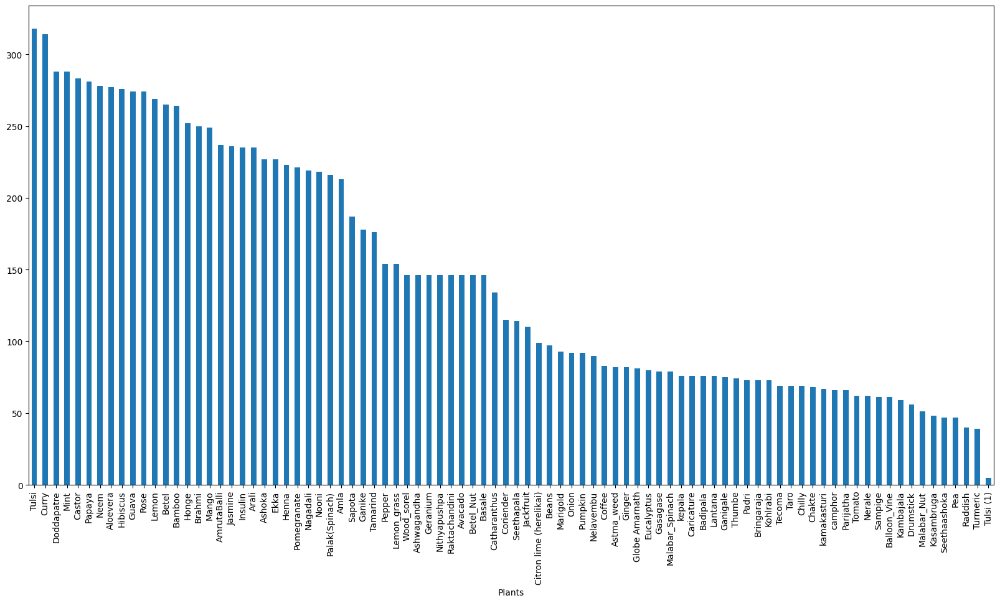

In [10]:
labels_df.Plants.value_counts().plot.bar(figsize=(20,10))

In [11]:
labels_df['Plants'].value_counts().median()

114.5

### Viewing Image

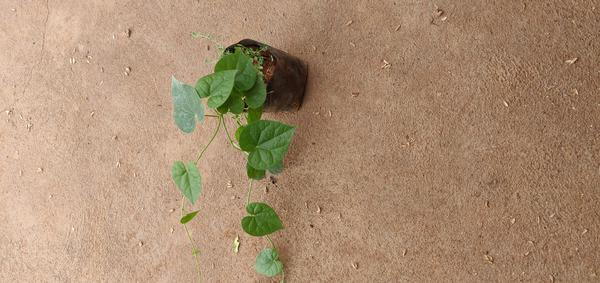

In [12]:
#Let's view an image
from IPython.display import Image
Image('/content/drive/MyDrive/PlantsUp/Merged_Dataset/AmrutaBalli/144.jpg')

In [13]:
labels_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 12810 entries, 0 to 12809
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   Plants  12810 non-null  object
 1   image   12810 non-null  object
dtypes: object(2)
memory usage: 200.3+ KB


In [14]:

# path = 'dataset/'


# im_size = 300

# images = []
# labels = []

# for i in dataset_path:
#     data_path = path + str(i)
#     filenames = [i for i in os.listdir(data_path) ]

#     for f in filenames:
#         img = cv2.imread(data_path + '/' + f)
#         img = cv2.resize(img, (im_size, im_size))
#         images.append(img)
#         labels.append(i)

### Making X and Y (filnames and Boolean_labels)

In [15]:
filenames = labels_df.image.to_list()
filenames[:10]
len(filenames)

12810

In [16]:
## Making labels to Boolean labels

#numpy_labels
labels = labels_df.Plants.to_numpy()
labels


array(['Gasagase', 'Gasagase', 'Gasagase', ..., 'AmrutaBalli',
       'AmrutaBalli', 'AmrutaBalli'], dtype=object)

In [17]:
#unique_labels
unique_labels = np.unique(labels)
print(unique_labels)
print(len(unique_labels))

['Aloevera' 'Amla' 'AmrutaBalli' 'Arali' 'Ashoka' 'Ashwagandha'
 'Astma_weed' 'Avacado' 'Badipala' 'Balloon_Vine' 'Bamboo' 'Basale'
 'Beans' 'Betel' 'Betel_Nut' 'Brahmi' 'Bringaraja' 'Caricature' 'Castor'
 'Catharanthus' 'Chakte' 'Chilly' 'Citron lime (herelikai)' 'Coffee'
 'Coriender' 'Curry' 'Doddapatre' 'Drumstick' 'Ekka' 'Eucalyptus'
 'Ganigale' 'Ganike' 'Gasagase' 'Geranium' 'Ginger' 'Globe Amarnath'
 'Guava' 'Henna' 'Hibiscus' 'Honge' 'Insulin' 'Jackfruit' 'Jasmine'
 'Kambajala' 'Kasambruga' 'Kohlrabi' 'Lantana' 'Lemon' 'Lemon_grass'
 'Malabar_Nut' 'Malabar_Spinach' 'Mango' 'Marigold' 'Mint' 'Nagadali'
 'Neem' 'Nelavembu' 'Nerale' 'Nithyapushpa' 'Nooni' 'Onion' 'Padri'
 'Palak(Spinach)' 'Papaya' 'Parijatha' 'Pea' 'Pepper' 'Pomegranate'
 'Pumpkin' 'Raddish' 'Raktachandini' 'Rose' 'Sampige' 'Sapota'
 'Seethaashoka' 'Seethapala' 'Tamarind' 'Taro' 'Tecoma' 'Thumbe' 'Tomato'
 'Tulsi' 'Tulsi (1)' 'Turmeric' 'Wood_sorel' 'camphor' 'kamakasturi'
 'kepala']
88


In [18]:
#boolean_labels
boolean_labels = [label == unique_labels for label in labels]
boolean_labels[:2]

[array([False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False,  True, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False]),
 array([False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False,  True, False, False, False,
        False, Fal

In [19]:
print(labels[0]) #original label
print(np.where(unique_labels == labels[0]))#index where label ocurs
print(boolean_labels[0].argmax())# index where label occurs in boolean array
print(boolean_labels[0].astype(int)) # 1 where label is occurs ,else 0.

Gasagase
(array([32]),)
32
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


In [20]:
# X and Y
X = filenames
Y = boolean_labels


### Preprocessing data(Turning images into tensors)

array([[[221, 223, 235],
        [200, 202, 214],
        [181, 183, 195],
        ...,
        [159, 160, 164],
        [171, 171, 179],
        [175, 178, 187]],

       [[215, 217, 229],
        [205, 207, 219],
        [192, 194, 206],
        ...,
        [162, 161, 166],
        [171, 171, 179],
        [175, 178, 187]],

       [[206, 208, 220],
        [209, 211, 223],
        [202, 204, 216],
        ...,
        [166, 165, 170],
        [171, 171, 179],
        [176, 176, 186]],

       ...,

       [[ 79,  78,  84],
        [ 81,  80,  86],
        [ 80,  78,  83],
        ...,
        [ 69,  60,  65],
        [ 58,  53,  60],
        [ 60,  59,  67]],

       [[ 62,  61,  67],
        [ 72,  71,  77],
        [ 76,  74,  79],
        ...,
        [ 64,  55,  60],
        [ 56,  53,  62],
        [ 61,  61,  71]],

       [[ 48,  47,  53],
        [ 63,  62,  68],
        [ 73,  71,  76],
        ...,
        [ 62,  56,  60],
        [ 60,  57,  68],
        [ 67,  67,  79]]], dtype=uint8)
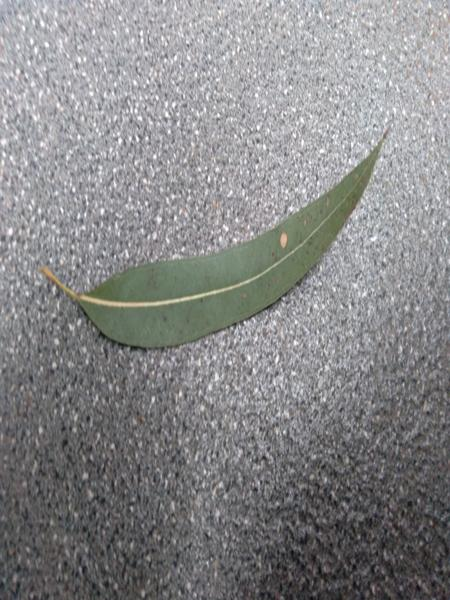

In [21]:
# to see what importing a images lookslike.
# Convert image to Numpy array

from matplotlib.pyplot import imread
image = imread(filenames[99])
image

In [22]:


IMG_SIZE = 300

# Create a function for preprocessing images
def process_images(image_path , img_size=IMG_SIZE):
  """
  Takes an image file path and turns the image into tensors.
  """
  # read in a image filepath
  image = tf.io.read_file(image_path) # return a tensor dtype string.

  # turns the jpeg image into numerical Tensor with # color channels(Red,Green,Blue)
  image = tf.image.decode_jpeg(image,channels=3) # takes argument as dtype string.

  # convert the colour channels values from 0-255 to 0-1 values(normalization)
  image = tf.image.convert_image_dtype(image, tf.float32)# can convert into types like uint32, uint64, int8, int16 ,float64, float32.

  # resize the image to our desired value(300,300)
  image = tf.image.resize(image, size=[img_size,img_size])

  return image

### Turning our data into batches

In [23]:
# Create a simple function to return a tuple(image,label)

def get_image_label_tuple(image_path, label):
  """
  takes an image file path name and th assosicated label, processses the image and returns a tuple of(image,label).
  """
  image = process_images(image_path)
  return image ,label

In [24]:
process_images(filenames[99])

<tf.Tensor: shape=(300, 300, 3), dtype=float32, numpy=
array([[[0.832353  , 0.84803927, 0.88333344],
        [0.7411765 , 0.75686276, 0.79215693],
        [0.69509804, 0.7107843 , 0.7460785 ],
        ...,
        [0.6406863 , 0.6416667 , 0.64950985],
        [0.63480395, 0.6387255 , 0.65539217],
        [0.6789216 , 0.6887255 , 0.7142157 ]],

       [[0.789706  , 0.80539227, 0.8406863 ],
        [0.789706  , 0.80539227, 0.8406863 ],
        [0.70882356, 0.72450984, 0.75980395],
        ...,
        [0.7166667 , 0.7166667 , 0.71862745],
        [0.6691177 , 0.67156863, 0.68235296],
        [0.67647064, 0.6862745 , 0.7117647 ]],

       [[0.7284314 , 0.74411774, 0.7794118 ],
        [0.7225491 , 0.73823535, 0.7735294 ],
        [0.6818628 , 0.69754905, 0.73284316],
        ...,
        [0.6730392 , 0.6730392 , 0.6730392 ],
        [0.6627451 , 0.6637255 , 0.6745098 ],
        [0.66862744, 0.6696079 , 0.69803923]],

       ...,

       [[0.29558825, 0.29950982, 0.3151961 ],
        [0.28

In [25]:
get_image_label_tuple(X[99],Y[99])

(<tf.Tensor: shape=(300, 300, 3), dtype=float32, numpy=
 array([[[0.832353  , 0.84803927, 0.88333344],
         [0.7411765 , 0.75686276, 0.79215693],
         [0.69509804, 0.7107843 , 0.7460785 ],
         ...,
         [0.6406863 , 0.6416667 , 0.64950985],
         [0.63480395, 0.6387255 , 0.65539217],
         [0.6789216 , 0.6887255 , 0.7142157 ]],
 
        [[0.789706  , 0.80539227, 0.8406863 ],
         [0.789706  , 0.80539227, 0.8406863 ],
         [0.70882356, 0.72450984, 0.75980395],
         ...,
         [0.7166667 , 0.7166667 , 0.71862745],
         [0.6691177 , 0.67156863, 0.68235296],
         [0.67647064, 0.6862745 , 0.7117647 ]],
 
        [[0.7284314 , 0.74411774, 0.7794118 ],
         [0.7225491 , 0.73823535, 0.7735294 ],
         [0.6818628 , 0.69754905, 0.73284316],
         ...,
         [0.6730392 , 0.6730392 , 0.6730392 ],
         [0.6627451 , 0.6637255 , 0.6745098 ],
         [0.66862744, 0.6696079 , 0.69803923]],
 
        ...,
 
        [[0.29558825, 0.29950982

In [26]:
# Define the batch size,32 is good.
BATCH_SIZE = 32

#Create a function to turn data into batches
def create_data_batches(X,Y=None , batch_size=BATCH_SIZE, valid_data=False ,test_data=False):
  """
  Creates batches of data out of image(X) and label(Y) pairs.
  shuffles the data if it's training data but doesn't shuffle if it's validation data.
  Also accepts test data as input(no labels).
  """
  # If the data is a test dataset, we probably don't have labels
  if test_data:
    print("Creating test data batches..")
    data = tf.data.Dataset.from_tensor_slices((tf.constant(X))) #only filepaths(no labels)
    data_batch = data.map(process_images).batch(BATCH_SIZE)
    return data_batch

  #If the data s a valid dataset, we don't need to shuffle it
  elif valid_data:
    print("Creating validation data batches...")
    data = tf.data.Dataset.from_tensor_slices((tf.constant(X),  # filepaths
                                               tf.constant(Y)))# labels
    data_batch = data.map(get_image_label_tuple).batch(BATCH_SIZE)
  else :
    print("Creating training data batches...")
    # turn filepaths and labels into Tensors
    data = tf.data.Dataset.from_tensor_slices((tf.constant(X),
                                              tf.constant(Y)))
    #shuffling pathnames and labels before mapping image processor function is faster than shuffing processed images
    data = data.shuffle(buffer_size=len(X))

    #Create (image,label) tuples(image to preprocessed image)
    data = data.map(get_image_label_tuple)

    # turn the training data into batches
    data_batch = data.batch(BATCH_SIZE)
  return data_batch

### Splitting into training and validation set.

In [27]:
# Set number of images to use Experimenting with slider
NUM_IMAGES = 2000 # @param {"type":"slider","min":2000,"max":12810,"step":1}

In [28]:
##Spilting train dataset into train and validation set
from sklearn.model_selection import train_test_split
X, Y = sklearn.utils.shuffle(X ,Y , random_state=99)
Xtrain,Xval,Ytrain,Yval = train_test_split(X[:NUM_IMAGES],
                                           Y[:NUM_IMAGES],
                                           test_size=0.2)
print(len(Xtrain),len(Xval),len(Ytrain),len(Yval))

1600 400 1600 400


In [29]:
# Create training and validation data batches
train_data = create_data_batches(Xtrain,Ytrain)
val_data = create_data_batches(Xval,Yval,valid_data=True)

Creating training data batches...
Creating validation data batches...


In [30]:
#Check out the differnt attributes or our data batches
train_data.element_spec , val_data.element_spec

((TensorSpec(shape=(None, 300, 300, 3), dtype=tf.float32, name=None),
  TensorSpec(shape=(None, 88), dtype=tf.bool, name=None)),
 (TensorSpec(shape=(None, 300, 300, 3), dtype=tf.float32, name=None),
  TensorSpec(shape=(None, 88), dtype=tf.bool, name=None)))

In [31]:
#### Visualizing dat batchess

import matplotlib.pyplot as plt
# create a function for viewing images in a data batch

def show_25_images(images,labels):
  """
  Displays a plot of 2 images and their labels from a data batch.
  """
  # setup the figure
  plt.figure(figsize=(10,10))
  #loop through 25 (for displaying 2 images)
  for i in range(25):
    #create subplots(5rows, 5columns)
    ax = plt.subplot(5,5,i+1)
    #Display the image
    plt.imshow(images[i])
    #add the images label as the title
    plt.title(unique_labels[labels[i].argmax()])
    #Turn the grid line off
    plt.axis("off")

# Building a model

In [47]:


# Setup input shape to the model
IMG_SIZE = 300  # EfficientNetB3 default input size
INPUT_SHAPE = (IMG_SIZE, IMG_SIZE, 3)  # height, width, color channels

# Setup output shape of our model
OUTPUT_SHAPE = len(unique_labels)  # Number of classes in the dataset

# Create a function to build the model
def create_model(input_shape=INPUT_SHAPE, output_shape=OUTPUT_SHAPE):
    print("Building model with EfficientNetB3 from tf.keras.applications")

    # Load EfficientNetB3 without the top classification layer (include_top=False)
    base_model = tf.keras.applications.EfficientNetB3(
        include_top=False,
        weights="imagenet",  # Use pretrained ImageNet weights
        input_shape=input_shape,
        pooling="avg"  # Global average pooling
    )

    # Freeze the base model initially
    base_model.trainable = True

    # Add custom classification layers
    model = tf.keras.Sequential([
        base_model,  # Base model for feature extraction
        tf.keras.layers.Dense(128, activation="relu"),  # Dense layer for feature learning
        tf.keras.layers.Dropout(0.5),  # Dropout for regularization
        tf.keras.layers.Dense(output_shape, activation="softmax")  # Output layer for multiclass classification
    ])

    # Compile the model
    model.compile(
        loss=tf.keras.losses.CategoricalCrossentropy(),  # Use sparse_categorical_crossentropy if labels are integers
        optimizer=tf.keras.optimizers.Adam(learning_rate=0.001),  # Adjust learning rate as needed
        metrics=["accuracy"]
    )

    return model


In [48]:

model = create_model()
model.summary()


Building model with EfficientNetB3 from tf.keras.applications
43941136/43941136 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step


Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ efficientnetb3 (Functional)          │ (None, 1536)                │      10,783,535 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 128)                 │         196,736 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout (Dropout)                    │ (None, 128)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 88)                  │          11,352 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 10,991,623 (41.93 MB)

 Trainable params: 10,904,320 (41.60 MB)

 Non-trainable params: 87,303 (341.03 KB)

### Callbacks

In [32]:
#Load TensorBoard notebook extension
%load_ext tensorboard

import datetime

# create a function to build a TensorBoard callback
def create_tensorboard_callback():
  # Create a log directory for storing TensorBoard logs
  logdir = os.path.join("drive/MyDrive/Deep_Learning/logs",# Make it so the logs get tracked whenever we run an experiment
                        datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
  return tf.keras.callbacks.TensorBoard(logdir)


# Creating an early stopping callback
early_stopping = tf.keras.callbacks.EarlyStopping(monitor="val_accuracy",patience=3)

### Training model

In [50]:
NUM_EPOCHS = 20

# Build a function to train and return a trained model
def train_model():
  """
  Trains a given model and returns the trained version.
  """
  # Create a model
  model = create_model()

  #Create new tensorboard session everytime we train a model
  tensorboard = create_tensorboard_callback()

  #Fit the momdel to the data passing it the callbacks we created
  model.fit(x=train_data,
            epochs=NUM_EPOCHS,
            validation_data = val_data,
            validation_freq=1,
            callbacks=[tensorboard])

  #Return model
  return model

In [ ]:
# Fit the model to the data
model = train_model()

Building model with EfficientNetB3 from tf.keras.applications
Epoch 1/20
 3/50 ━━━━━━━━━━━━━━━━━━━━ 31:37 40s/step - accuracy: 0.0000e+00 - loss: 4.5931

### Saving Model

In [33]:
#Create a function to save a model.

def save_model(model,suffix=None):
  """
  Saves a given model in a models directory and appends a suffix(string) .
  """
  #Create a model directory pathname with current time
  modeldir = os.path.join("drive/MyDrive/Deep_Learning/models",
                          datetime.datetime.now().strftime("%d%m%Y-%H%M%S"))
  model_path = modeldir + "-" + suffix + ".h5" # save format of model
  print(f"Saving model to:{model_path}...")
  model.save(model_path)
  return model_path



#Create a function to lad a model.
def load_a_model(model_path):
  """
  Loads a saved model from a specified path.
  """
  print(f"Loading saved model from:{model_path}...")
  model = tf.keras.models.load_model(model_path,custom_objects={"KerasLayer":hub.KerasLayer})
  return model

In [ ]:
save_model(model,suffix="updated-2000-images-effiecientnetb3-Adam")

Saving model to:drive/MyDrive/Deep_Learning/models/23122024-171857-updated-2000-images-effiecientnetb3-Adam.h5...


'drive/MyDrive/Deep_Learning/models/23122024-171857-updated-2000-images-effiecientnetb3-Adam.h5'

In [ ]:
%tensorboard --logdir drive/MyDrive/Deep_Learning/logs

Launching TensorBoard...

<IPython.core.display.Javascript object>

# Evaluating model

In [ ]:
predictions = model.predict(val_data,verbose=1)
predictions

13/13 ━━━━━━━━━━━━━━━━━━━━ 41s 2s/step


array([[7.3128845e-09, 1.2771436e-08, 6.1032692e-06, ..., 3.1518652e-11,
        4.9301868e-10, 1.4709242e-10],
       [7.6701207e-04, 3.8327911e-04, 1.6786827e-04, ..., 4.0274099e-05,
        5.3503911e-05, 5.3364380e-05],
       [1.1358865e-06, 8.4705898e-06, 3.6986447e-05, ..., 6.2019937e-03,
        2.1665867e-06, 4.8388589e-02],
       ...,
       [6.4455274e-10, 2.5843650e-11, 1.1948023e-10, ..., 1.8328436e-08,
        7.0536236e-13, 2.5155833e-10],
       [5.8922257e-08, 2.0659441e-05, 2.8241187e-08, ..., 8.8049845e-11,
        4.5270658e-09, 1.4125019e-10],
       [3.5979976e-06, 4.4635913e-06, 3.3512712e-05, ..., 5.4314182e-07,
        2.8897009e-07, 6.7602400e-08]], dtype=float32)

In [34]:
# Turning this into function.

def get_pred_label(predictions):
  """
  Finding maximum predicted label for a prediction.Turns an array of prediction probabilities into a label.
  """
  return unique_labels[np.argmax(predictions)]



In [35]:
images_ = []
labels_  = []
for i,l in val_data.unbatch().as_numpy_iterator():
  images_.append(i)
  labels_.append(l)



In [36]:
# A function of unbatch validation data.
def unbatchify(dataset):
  """
  Takes a batched dataset of (image,label)Tensors and returns the image and label seperately
  """
  images = []
  labels = []
  for i,l in dataset.unbatch().as_numpy_iterator():
    images.append(i)
    labels.append(l)
  return images,labels


val_images , val_labels = unbatchify(val_data)


In [37]:
def plot_pred(images,labels,prediction_probabilities,n):
  """
  View the image , it's true label and predicted label.
  """
  #get pred label
  pred_label = get_pred_label(prediction_probabilities[n])

  #get truth label
  true_label = get_pred_label(labels[n])

  #change color on right or wrong
  if pred_label == true_label:
    color = "green"
  else:
    color = "red"


  # plot image & remove ticks
  image = images[n]
  plt.imshow(image)
  plt.xticks([])
  plt.yticks([])

  plt.title("{} {:2.0f}% {}".format(pred_label,np.max(prediction_probabilities[n])*100,true_label),color=color)


In [38]:
def plot_pred_conf(prediction_probabilities, labels, n):
    """
    Plots the top 10 highest prediction confidences along with the truth label for a sample n.
    """
    pred_prob= prediction_probabilities[n]

    #get pred label
    pred_label = get_pred_label(prediction_probabilities[n])

    #get truth label
    true_label = get_pred_label(labels[n])

    # Find the top 10 prediction confidence indexes
    top_10_pred_indexes = pred_prob.argsort()[-10:][::-1]

    # Find the top 10 prediction labels
    top_10_pred_labels = unique_labels[top_10_pred_indexes]

    # Find the top 10 prediction values
    top_10_pred_values = pred_prob[top_10_pred_indexes]

    # Setup plot
    top_plot = plt.bar(np.arange(len(top_10_pred_labels)),
                       top_10_pred_values,
                       color="grey")

    plt.xticks(np.arange(len(top_10_pred_labels)),
               labels=top_10_pred_labels,
               rotation="vertical")

  #change color of true label
    if np.isin(true_label,top_10_pred_labels):
     top_plot[np.argmax(top_10_pred_labels == true_label)].set_color("green")
    else:
      pass
    #print(pred_label,true_label)

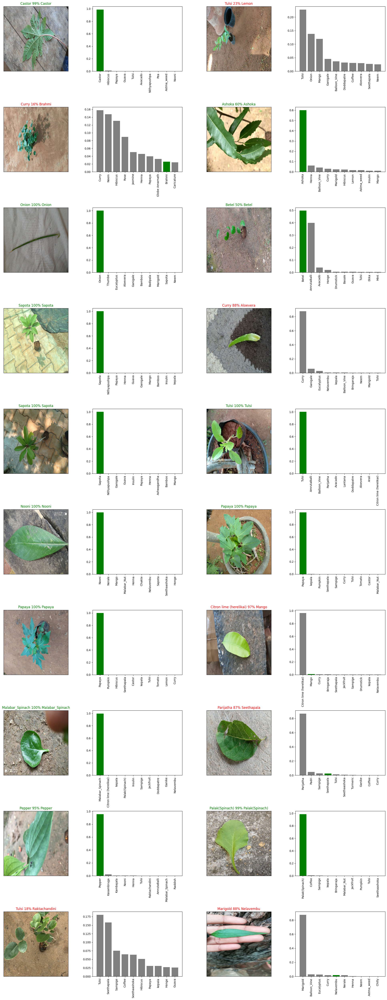

In [ ]:
# let's vosualize the evaluation

i_multiplier = 20
num_rows = 10
num_columns = 2
num_images = num_rows * num_columns
plt.figure(figsize=(10*num_columns,5*num_rows))

for i in range(num_images):
  plt.subplot(num_rows,2*num_columns,2*i+1)
  plot_pred(prediction_probabilities=predictions,
            labels = val_labels,
            images = val_images,
            n = i+i_multiplier)
  plt.subplot(num_rows,2*num_columns,2*i+2)
  plot_pred_conf(prediction_probabilities=predictions,
                 labels = val_labels,
                 n = i+i_multiplier)

plt.tight_layout(h_pad=1.0)
plt.show()

In [ ]:
model.evaluate(val_data)

13/13 ━━━━━━━━━━━━━━━━━━━━ 17s 1s/step - accuracy: 0.6435 - loss: 2.2693


[2.335066318511963, 0.6424999833106995]

### Building, testing new model

In [39]:


# Setup input shape to the model
IMG_SIZE = 300  # EfficientNetB3 default input size
INPUT_SHAPE = (IMG_SIZE, IMG_SIZE, 3)  # height, width, color channels

# Setup output shape of our model
OUTPUT_SHAPE = len(unique_labels)  # Number of classes in the dataset

# Create a function to build the model
def create_model(input_shape=INPUT_SHAPE, output_shape=OUTPUT_SHAPE):
    print("Building model with EfficientNetB3 from tf.keras.applications")

    # Load EfficientNetB3 without the top classification layer (include_top=False)
    base_model = tf.keras.applications.EfficientNetB3(
        include_top=False,
        weights="imagenet",  # Use pretrained ImageNet weights
        input_shape=input_shape,
        pooling="avg"  # Global average pooling
    )

    # Freeze the base model initially
    base_model.trainable = True

    # Add custom classification layers
    model = tf.keras.Sequential([
        base_model,  # Base model for feature extraction
        tf.keras.layers.Dense(128, activation="relu"),  # Dense layer for feature learning
        tf.keras.layers.Dropout(0.3),  # Dropout for regularization
        tf.keras.layers.Dense(output_shape, activation="softmax",kernel_regularizer=tf.keras.regularizers.l2(0.01))  # Output layer for multiclass classification
    ])

    # Compile the model
    model.compile(
        loss=tf.keras.losses.CategoricalCrossentropy(),  # Use sparse_categorical_crossentropy if labels are integers
        optimizer=tf.keras.optimizers.Adam(learning_rate=0.001),  # Adjust learning rate as needed
        metrics=["accuracy"]
    )

    return model


In [40]:
NUM_EPOCHS = 7

# Build a function to train and return a trained model
def train_model():
  """
  Trains a given model and returns the trained version.
  """
  # Create a model
  model = create_model()

  #Create new tensorboard session everytime we train a model
  tensorboard = create_tensorboard_callback()

  #Fit the momdel to the data passing it the callbacks we created
  model.fit(x=train_data,
            epochs=NUM_EPOCHS,
            validation_data = val_data,
            validation_freq=1,
            callbacks=[tensorboard])

  #Return model
  return model

In [ ]:

new_model = create_model()
new_model.summary()


Building model with EfficientNetB3 from tf.keras.applications
43941136/43941136 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step


Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ efficientnetb3 (Functional)          │ (None, 1536)                │      10,783,535 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 128)                 │         196,736 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout (Dropout)                    │ (None, 128)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 88)                  │          11,352 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 10,991,623 (41.93 MB)

 Trainable params: 10,904,320 (41.60 MB)

 Non-trainable params: 87,303 (341.03 KB)

In [ ]:
# Fit the model to the data
new_model = train_model()

Building model with EfficientNetB3 from tf.keras.applications
Epoch 1/22
50/50 ━━━━━━━━━━━━━━━━━━━━ 536s 8s/step - accuracy: 0.1142 - loss: 5.0508 - val_accuracy: 0.0225 - val_loss: 5.2494
Epoch 2/22
50/50 ━━━━━━━━━━━━━━━━━━━━ 68s 1s/step - accuracy: 0.4721 - loss: 2.9500 - val_accuracy: 0.0025 - val_loss: 5.1852
Epoch 3/22
50/50 ━━━━━━━━━━━━━━━━━━━━ 88s 1s/step - accuracy: 0.6568 - loss: 2.0274 - val_accuracy: 0.0125 - val_loss: 5.3237
Epoch 4/22
50/50 ━━━━━━━━━━━━━━━━━━━━ 76s 1s/step - accuracy: 0.7863 - loss: 1.3560 - val_accuracy: 0.0175 - val_loss: 5.1139
Epoch 5/22
50/50 ━━━━━━━━━━━━━━━━━━━━ 83s 1s/step - accuracy: 0.8834 - loss: 0.9370 - val_accuracy: 0.0150 - val_loss: 5.0230
Epoch 6/22
50/50 ━━━━━━━━━━━━━━━━━━━━ 67s 1s/step - accuracy: 0.8749 - loss: 0.8734 - val_accuracy: 0.0225 - val_loss: 5.1145
Epoch 7/22
50/50 ━━━━━━━━━━━━━━━━━━━━ 91s 2s/step - accuracy: 0.9369 - loss: 0.6704 - val_accuracy: 0.0075 - val_loss: 5.0891
Epoch 8/22
50/50 ━━━━━━━━━━━━━━━━━━━━ 75s 1s/step - acc

In [ ]:
save_model(new_model,suffix="new_updated-2000-images-effiecientnetb3-Adam")

In [ ]:
#loading model
new_model = load_a_model('/content/drive/MyDrive/Deep_Learning/models/24122024-084145-new_updated-2000-images-effiecientnetb3-Adam.h5')

Loading saved model from:/content/drive/MyDrive/Deep_Learning/models/24122024-084145-new_updated-2000-images-effiecientnetb3-Adam.h5...


In [ ]:
predictions = new_model.predict(val_data,verbose=1)
predictions

13/13 ━━━━━━━━━━━━━━━━━━━━ 119s 7s/step


array([[2.4484331e-07, 7.4271078e-08, 1.5438623e-06, ..., 4.5378283e-06,
        4.4396623e-07, 1.5740826e-08],
       [1.6999186e-06, 7.7749229e-07, 1.8522250e-07, ..., 1.3336890e-07,
        1.9107750e-07, 4.1785121e-08],
       [1.4807112e-12, 8.2664747e-10, 2.1647331e-11, ..., 1.8486180e-09,
        2.0079201e-12, 1.4491694e-08],
       ...,
       [2.8432262e-07, 3.8171594e-05, 3.4960675e-07, ..., 1.7117562e-05,
        4.8922398e-06, 6.6743473e-06],
       [7.0918094e-07, 7.0189663e-09, 1.7005357e-08, ..., 1.8594230e-08,
        7.4781633e-06, 1.4712222e-08],
       [1.5551511e-10, 3.8185544e-08, 1.9039978e-10, ..., 1.4198079e-10,
        3.5756707e-11, 8.5405510e-10]], dtype=float32)

In [ ]:
new_model.evaluate(val_data)

13/13 ━━━━━━━━━━━━━━━━━━━━ 33s 2s/step - accuracy: 0.9519 - loss: 0.3771


[0.40988731384277344, 0.9399999976158142]

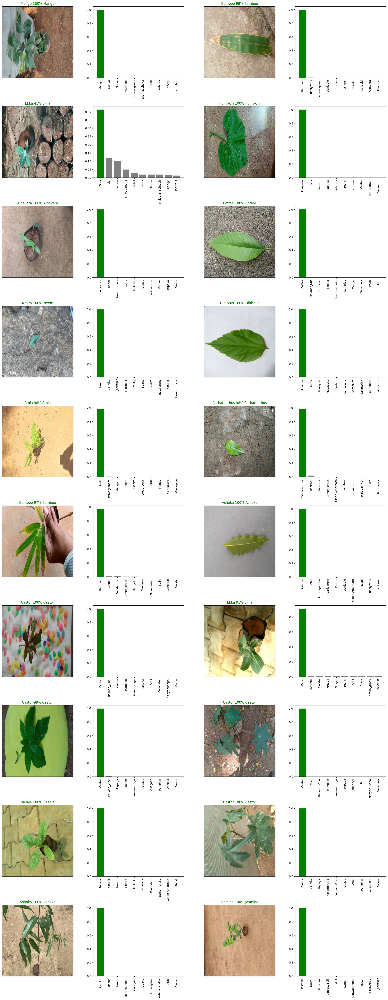

In [ ]:
# let's vosualize the evaluation

i_multiplier = 20
num_rows = 10
num_columns = 2
num_images = num_rows * num_columns
plt.figure(figsize=(10*num_columns,5*num_rows))

for i in range(num_images):
  plt.subplot(num_rows,2*num_columns,2*i+1)
  plot_pred(prediction_probabilities=predictions,
            labels = val_labels,
            images = val_images,
            n = i+i_multiplier)
  plt.subplot(num_rows,2*num_columns,2*i+2)
  plot_pred_conf(prediction_probabilities=predictions,
                 labels = val_labels,
                 n = i+i_multiplier)

plt.tight_layout(h_pad=1.0)
plt.show()

# Training full model

In [41]:
## creating Batches for full data
full_data = create_data_batches(X,Y)

Creating training data batches...


In [42]:
full_data

<_BatchDataset element_spec=(TensorSpec(shape=(None, 300, 300, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 88), dtype=tf.bool, name=None))>

In [ ]:
# Create a model for full model
full_model = create_model()

Building model with EfficientNetB3 from tf.keras.applications
43941136/43941136 ━━━━━━━━━━━━━━━━━━━━ 3s 0us/step


In [ ]:
# creating full model callbacks
full_model_tensorboard = create_tensorboard_callback()

#There's No validation set wen traing an all the data, so we can't monitor validation accuracy
full_model_early_stopping = tf.keras.callbacks.EarlyStopping(monitor="accuracy",patience=3)

In [ ]:
# Fit the model to full data
full_model.fit(x = full_data,
               epochs = NUM_EPOCHS,
               callbacks= [full_model_tensorboard,full_model_early_stopping])

Epoch 1/7
401/401 ━━━━━━━━━━━━━━━━━━━━ 5436s 13s/step - accuracy: 0.4033 - loss: 3.2972
Epoch 2/7
401/401 ━━━━━━━━━━━━━━━━━━━━ 512s 1s/step - accuracy: 0.8442 - loss: 0.9078
Epoch 3/7
401/401 ━━━━━━━━━━━━━━━━━━━━ 500s 1s/step - accuracy: 0.9117 - loss: 0.5532
Epoch 4/7
401/401 ━━━━━━━━━━━━━━━━━━━━ 504s 1s/step - accuracy: 0.9288 - loss: 0.4253
Epoch 5/7
401/401 ━━━━━━━━━━━━━━━━━━━━ 471s 1s/step - accuracy: 0.9560 - loss: 0.3122
Epoch 6/7
401/401 ━━━━━━━━━━━━━━━━━━━━ 507s 1s/step - accuracy: 0.9544 - loss: 0.2889
Epoch 7/7
401/401 ━━━━━━━━━━━━━━━━━━━━ 498s 1s/step - accuracy: 0.9429 - loss: 0.3297


In [ ]:
save_model(full_model,suffix="full-data-efficientnetb3_adam_model")

Saving model to:drive/MyDrive/Deep_Learning/models/25122024-120825-full-data-efficientnetb3_adam_model.h5...


'drive/MyDrive/Deep_Learning/models/25122024-120825-full-data-efficientnetb3_adam_model.h5'

### Loading Full model

In [43]:
loaded_full_model = load_a_model('drive/MyDrive/Deep_Learning/models/25122024-120825-full-data-efficientnetb3_adam_model.h5')
loaded_full_model.summary()

Loading saved model from:drive/MyDrive/Deep_Learning/models/25122024-120825-full-data-efficientnetb3_adam_model.h5...


Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ efficientnetb3 (Functional)          │ (None, 1536)                │      10,783,535 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 128)                 │         196,736 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout (Dropout)                    │ (None, 128)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 88)                  │          11,352 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 10,991,625 (41.93 MB)

 Trainable params: 10,904,320 (41.60 MB)

 Non-trainable params: 87,303 (341.03 KB)

 Optimizer params: 2 (12.00 B)

# Making predictions on test dataset

In [113]:
#load test image filenames
import os
import numpy as np
test_path = "/content/drive/MyDrive/PlantsUp/test/"

test_filenames = [test_path + fname for fname in os.listdir(test_path)]
test_filenames

['/content/drive/MyDrive/PlantsUp/test/images (1).jpg',
 '/content/drive/MyDrive/PlantsUp/test/images (3).jpg',
 '/content/drive/MyDrive/PlantsUp/test/WIN_20241226_13_08_15_Pro.jpg',
 '/content/drive/MyDrive/PlantsUp/test/WIN_20241226_13_11_06_Pro.jpg',
 '/content/drive/MyDrive/PlantsUp/test/Sita-Ashok_(Saraca_asoca)_leaf_in_Kolkata_W_IMG_2268.jpg']

In [114]:
# Creatin test_data batches
test_data = create_data_batches(test_filenames,test_data=True)

Creating test data batches..


In [115]:


test_data

<_BatchDataset element_spec=TensorSpec(shape=(None, 300, 300, 3), dtype=tf.float32, name=None)>

In [116]:
#Make predictions on test data batch using the loaded model
test_prediction = loaded_full_model.predict(test_data,verbose=1)

1/1 ━━━━━━━━━━━━━━━━━━━━ 9s 9s/step


In [117]:
for i in range(0,len(test_filenames)):
  print(get_pred_label(test_prediction[i]), test_filenames[i])

Mint /content/drive/MyDrive/PlantsUp/test/images (1).jpg
Doddapatre /content/drive/MyDrive/PlantsUp/test/images (3).jpg
Seethaashoka /content/drive/MyDrive/PlantsUp/test/WIN_20241226_13_08_15_Pro.jpg
Seethaashoka /content/drive/MyDrive/PlantsUp/test/WIN_20241226_13_11_06_Pro.jpg
Nooni /content/drive/MyDrive/PlantsUp/test/Sita-Ashok_(Saraca_asoca)_leaf_in_Kolkata_W_IMG_2268.jpg


In [110]:
loaded_small_model = load_a_model('/content/drive/MyDrive/Deep_Learning/models/24122024-084145-new_updated-2000-images-effiecientnetb3-Adam.h5')
loaded_small_model.summary()

Loading saved model from:/content/drive/MyDrive/Deep_Learning/models/24122024-084145-new_updated-2000-images-effiecientnetb3-Adam.h5...


Model: "sequential_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ efficientnetb3 (Functional)          │ (None, 1536)                │      10,783,535 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 128)                 │         196,736 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_1 (Dropout)                  │ (None, 128)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 88)                  │          11,352 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 10,991,625 (41.93 MB)

 Trainable params: 10,904,320 (41.60 MB)

 Non-trainable params: 87,303 (341.03 KB)

 Optimizer params: 2 (12.00 B)

In [111]:
#Make predictions on test data batch using the loaded model
test_s_prediction = loaded_full_model.predict(test_data,verbose=1)

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


In [112]:
for i in range(0,len(test_filenames)):
  print(get_pred_label(test_s_prediction[i]), test_filenames[i])

Mint /content/drive/MyDrive/PlantsUp/test/images (1).jpg
Doddapatre /content/drive/MyDrive/PlantsUp/test/images (3).jpg
Seethaashoka /content/drive/MyDrive/PlantsUp/test/WIN_20241226_13_08_15_Pro.jpg
Seethaashoka /content/drive/MyDrive/PlantsUp/test/WIN_20241226_13_11_06_Pro.jpg
